In [1]:
import torch
import utils
import librosa
import IPython.display as ipd

In [2]:
# load models
directory = "./data/pytorch_model/"
ae_model = torch.load(f"{directory}autoencoder.pt")
ae_model.eval()
e_model = torch.load(f"{directory}encoder.pt")
e_model.eval()
d_model = torch.load(f"{directory}decoder.pt")
d_model.eval()

directory = "./data/pytorch_model/"
aeg_model = torch.load(f"{directory}autoencoder_glissando.pt")
ae_model.eval()
eg_model = torch.load(f"{directory}encoder_glissando.pt")
eg_model.eval()
dg_model = torch.load(f"{directory}decoder_glissando.pt")
dg_model.eval()

print()

# 1 周波数スペクトログラムによる特徴量抽出
波形をそのまま学習させるよりも、フーリエ変換した結果の周波数スペクトルを特徴量として用いた。その際、各周波数について振幅と位相のデータが得られるが、今回は位相のデータは除いて学習を行った。（一般的にスペクトログラムも、振幅のみ示されたグラフである）

位相のデータがある状態とない状態で周波数領域から音声の復元を行うと、音質が劣化するもの、曲が聴こえる程度には復元が行われた。

/home/yasu/.local/lib/python3.8/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


元データ：


振幅＋位相データからの復元：


振幅データからの復元：


スペクトログラム：


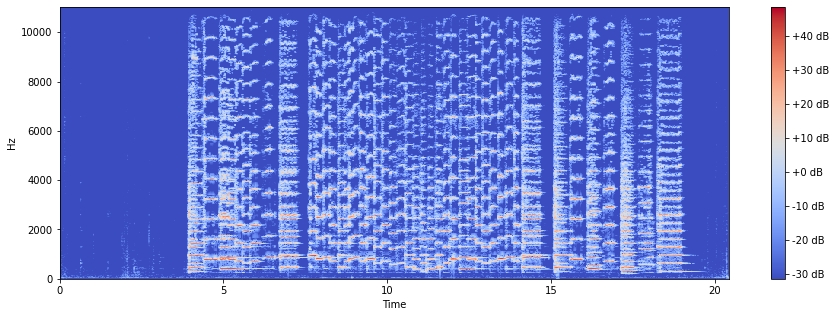

In [3]:
audio, sampling_rate = librosa.load('./data/test/gavotte.m4a')

hop_length = 512
n_fft = 2048
stft_result = librosa.stft(audio, n_fft=n_fft, hop_length=hop_length)
reconstructed_audio = librosa.istft(stft_result)
reconstructed_audio_nophase = librosa.istft(abs(stft_result))

print("元データ：")
ipd.display(ipd.Audio(audio, rate=sampling_rate))
print("振幅＋位相データからの復元：")
ipd.display(ipd.Audio(reconstructed_audio, rate=sampling_rate))
print("振幅データからの復元：")
ipd.display(ipd.Audio(reconstructed_audio_nophase, rate=sampling_rate))
print("スペクトログラム：")
utils.plot_stft(abs(stft_result), sampling_rate)


# 2 学習データ
## 2a 音階

/home/yasu/.local/lib/python3.8/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


stft.shape:(1025, 744)


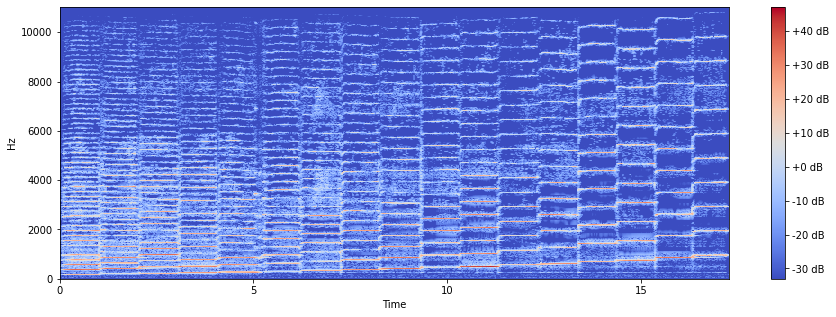

In [4]:
audio, sr = librosa.load("./data/training/Scale.m4a")
stft = utils.audio2stft(audio, sr)
stft = stft[:,85:-65] # clip to remove silent parts.
print(f"stft.shape:{stft.shape}")
utils.plot_stft(stft, sr)
ipd.Audio(audio, rate=sr)

## 2b グリッサンド奏法

/home/yasu/.local/lib/python3.8/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


stft.shape:(1025, 1094)


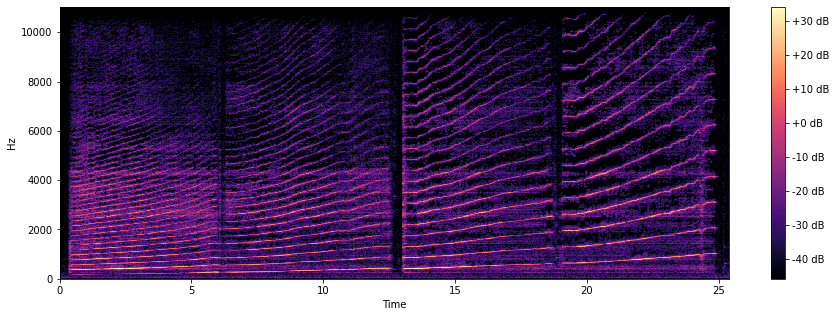

In [5]:
audio, sr = librosa.load("./data/training/Glissando.m4a")
stft = utils.audio2stft(audio, sr)
stft = stft[:,45:-40] # clip to remove silent parts.
print(f"stft.shape:{stft.shape}")
utils.plot_stft(stft, sr)
ipd.Audio(audio, rate=sr)

# 3 演奏データへの適用
比較的単純な曲として、「さんぽ」の演奏データに対して上のデータで学習されたオートエンコーダを用いてエンコーディングとデコーディングを行った。以下で用いられる`utils.visualizeAE()`という関数は、音声ファイルとオートエンコーダのモデルを引数として与えることで、元の音声データ、3次元の潜在空間のプロット、最終的な出力音声データを表示する。
## さんぽ

学習データ：音階


/home/yasu/.local/lib/python3.8/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


Input(original audio) (1025 x 2009):


Latent space (3 x 2009):
expected file size: 24.108 kB
visualization:


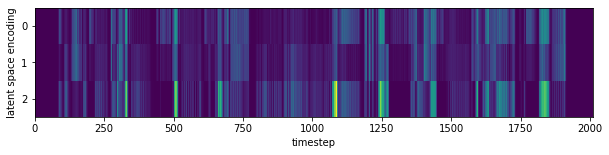

Output(audio reconstructed from autoencoder):


In [6]:
print("学習データ：音階")
_, latent_representation = utils.visualizeAE("./data/test/sampo.m4a", ae_model, e_model)

学習データ：グリッサンド


/home/yasu/.local/lib/python3.8/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


Input(original audio) (1025 x 2009):


Latent space (3 x 2009):
expected file size: 24.108 kB
visualization:


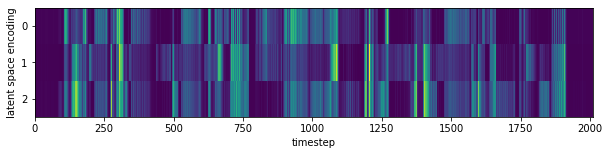

Output(audio reconstructed from autoencoder):


In [7]:
print("学習データ：グリッサンド")
_, latent_representation = utils.visualizeAE("./data/test/sampo.m4a", aeg_model, eg_model)

どちらも、聴けば「さんぽ」だと分かる程度には復元できているが、音質の劣化が顕著で、実用的には使えない。音階を学習データとしたモデルについて、もとの学習データに存在しない音については再現性が悪く、全く異なる音に聴こえる。音階の間を「補間」するような汎化は行われていないと考えられる。グリッサンドを学習データとしたモデルについては、全ての音符についての学習データが揃っているものの、全体的な音質は音階によるモデルより悪く聴こえる。

以下では、まだ音質がましな、音階により学習されたモデルについて、様々な曲を入力してみた結果を、記録として残しておく。

## バッハ：2つのヴァイオリンのための協奏曲

/home/yasu/.local/lib/python3.8/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


Input(original audio) (1025 x 485):


Latent space (3 x 485):
expected file size: 5.82 kB
visualization:


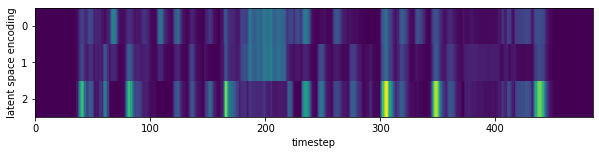

Output(audio reconstructed from autoencoder):


In [8]:
_ = utils.visualizeAE("./data/test/Bach.m4a", ae_model, e_model)

## バッハ：パルティータ第2番　シャコンヌ

/home/yasu/.local/lib/python3.8/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


Input(original audio) (1025 x 1281):


Latent space (3 x 1281):
expected file size: 15.372 kB
visualization:


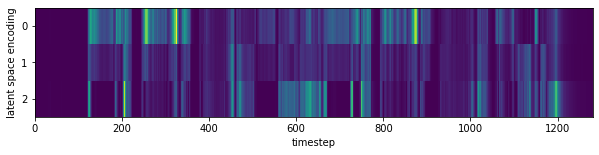

Output(audio reconstructed from autoencoder):


In [9]:
_ = utils.visualizeAE("./data/test/Chaconne.m4a", ae_model, e_model)

重音（一度に複数の音を演奏する手法）が多く用いられる曲だが、重音は再現されず、元の曲が分からないほどである。

## チャルダッシュ

/home/yasu/.local/lib/python3.8/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


Input(original audio) (1025 x 2234):


Latent space (3 x 2234):
expected file size: 26.808 kB
visualization:


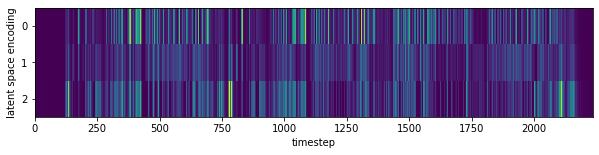

Output(audio reconstructed from autoencoder):


In [10]:
_ = utils.visualizeAE("./data/test/Czardas.m4a", ae_model, e_model)

## パッヘルベルのカノン

/home/yasu/.local/lib/python3.8/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


Input(original audio) (1025 x 980):


Latent space (3 x 980):
expected file size: 11.76 kB
visualization:


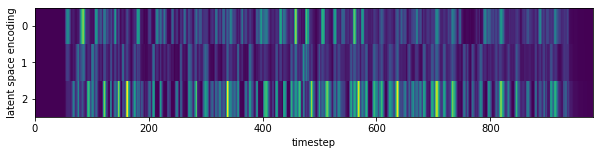

Output(audio reconstructed from autoencoder):


In [11]:
_ = utils.visualizeAE("./data/test/Canon in D.m4a", ae_model, e_model)